<a href="https://colab.research.google.com/github/Joanne-kendrick/Machine-Learning/blob/main/Final_wine_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# ML CLASSIFICATION COURSEWORK
# WINE DATASET
#GROUP ASSIGNMENT
#NALIKKA JOAN DEBORAH
#OKELLO ANDREW PETERS

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')

In [ ]:
df=pd.read_csv('https://raw.githubusercontent.com/Joanne-kendrick/Machine-Learning/refs/heads/main/wine_dataset.csv')


In [ ]:
df_1 =df.copy()
df_2=df.copy()

In [ ]:
df.shape

(178, 14)

In [ ]:
df.info()
# Show feature names, number of non-empty column for each and their data types

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Alcohol                       178 non-null    float64
 1   Malicacid                     178 non-null    float64
 2   Ash                           178 non-null    float64
 3   Alcalinity_of_ash             178 non-null    float64
 4   Magnesium                     178 non-null    int64  
 5   Total_phenols                 178 non-null    float64
 6   Flavanoids                    178 non-null    float64
 7   Nonflavanoid_phenols          178 non-null    float64
 8   Proanthocyanins               178 non-null    float64
 9   Color_intensity               178 non-null    float64
 10  Hue                           178 non-null    float64
 11  0D280_0D315_of_diluted_wines  178 non-null    float64
 12  Proline                       178 non-null    int64  
 13  targe

In [ ]:
X = df.drop(columns=['target'])
y =df['target']

In [ ]:
Stats = X.describe()
skewness = X.skew()
kurtosis = X.kurtosis()
print(Stats)
print(skewness)
print(kurtosis)

          Alcohol   Malicacid         Ash  Alcalinity_of_ash   Magnesium  \
count  178.000000  178.000000  178.000000         178.000000  178.000000   
mean    13.000618    2.336348    2.366517          19.494944   99.741573   
std      0.811827    1.117146    0.274344           3.339564   14.282484   
min     11.030000    0.740000    1.360000          10.600000   70.000000   
25%     12.362500    1.602500    2.210000          17.200000   88.000000   
50%     13.050000    1.865000    2.360000          19.500000   98.000000   
75%     13.677500    3.082500    2.557500          21.500000  107.000000   
max     14.830000    5.800000    3.230000          30.000000  162.000000   

       Total_phenols  Flavanoids  Nonflavanoid_phenols  Proanthocyanins  \
count     178.000000  178.000000            178.000000       178.000000   
mean        2.295112    2.029270              0.361854         1.590899   
std         0.625851    0.998859              0.124453         0.572359   
min         0.9

In [ ]:
print (X.shape)
print (y.shape)

(178, 13)
(178,)


In [ ]:
# 1. Data cleaning & wrangling
#check for missing values
print("Missing Values in each column: \n", df.isnull().sum())

Missing Values in each column: 
 Alcohol                         0
Malicacid                       0
Ash                             0
Alcalinity_of_ash               0
Magnesium                       0
Total_phenols                   0
Flavanoids                      0
Nonflavanoid_phenols            0
Proanthocyanins                 0
Color_intensity                 0
Hue                             0
0D280_0D315_of_diluted_wines    0
Proline                         0
target                          0
dtype: int64


In [ ]:
#check for duplicates:
df.duplicated().sum()

0

In [ ]:
df.head(10)

,Alcohol,Malicacid,Ash,Alcalinity_of_ash,Magnesium,Total_phenols,Flavanoids,Nonflavanoid_phenols,Proanthocyanins,Color_intensity,Hue,0D280_0D315_of_diluted_wines,Proline,target
0,14.23,1.71,2.43,15.6,127,2.80,3.06,0.28,2.29,5.64,1.04,3.92,1065,1
1,13.20,1.78,2.14,11.2,100,2.65,2.76,0.26,1.28,4.38,1.05,3.40,1050,1
2,13.16,2.36,2.67,18.6,101,2.80,3.24,0.30,2.81,5.68,1.03,3.17,1185,1
3,14.37,1.95,2.50,16.8,113,3.85,3.49,0.24,2.18,7.80,0.86,3.45,1480,1
4,13.24,2.59,2.87,21.0,118,2.80,2.69,0.39,1.82,4.32,1.04,2.93,735,1
5,14.20,1.76,2.45,15.2,112,3.27,3.39,0.34,1.97,6.75,1.05,2.85,1450,1
6,14.39,1.87,2.45,14.6,96,2.50,2.52,0.30,1.98,5.25,1.02,3.58,1290,1
7,14.06,2.15,2.61,17.6,121,2.60,2.51,0.31,1.25,5.05,1.06,3.58,1295,1
8,14.83,1.64,2.17,14.0,97,2.80,2.98,0.29,1.98,5.20,1.08,2.85,1045,1
9,13.86,1.35,2.27,16.0,98,2.98,3.15,0.22,1.85,7.22,1.01,3.55,1045,1


{'Alcohol': [], 'Malicacid': [123, 137, 173], 'Ash': [25, 59, 121], 'Alcalinity_of_ash': [59, 73, 121, 127], 'Magnesium': [69, 73, 78, 95], 'Total_phenols': [], 'Flavanoids': [], 'Nonflavanoid_phenols': [], 'Proanthocyanins': [95, 110], 'Color_intensity': [151, 158, 159, 166], 'Hue': [115], '0D280_0D315_of_diluted_wines': [], 'Proline': [], 'target': []}




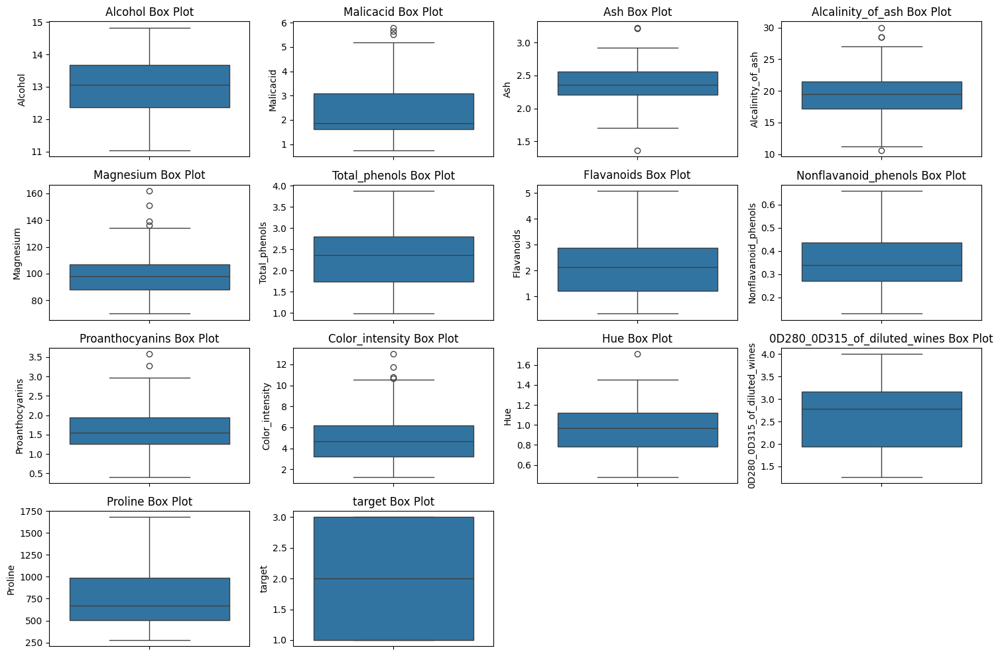

In [ ]:
#Check for outliers
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Define a function to calculate outliers using IQR
def detect_outliers_iqr(df):
    outliers = {}
    for feature in df.columns:
        Q1 = df[feature].quantile(0.25)
        Q3 = df[feature].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers[feature] = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)].index.tolist()
    return outliers

# Detect outliers in the wine dataset
outliers = detect_outliers_iqr(df)
print(outliers)
print ("\n")
# Plot box plots for all features
plt.figure(figsize=(15, 10))
for i, feature in enumerate(df.columns):
    plt.subplot(4, 4, i+1)
    sns.boxplot(df[feature])
    plt.title(f'{feature} Box Plot')
    plt.tight_layout()
plt.show()

For now lets work with the outliers since they're few. We shall determine if we cap them later to improve the performance of the model

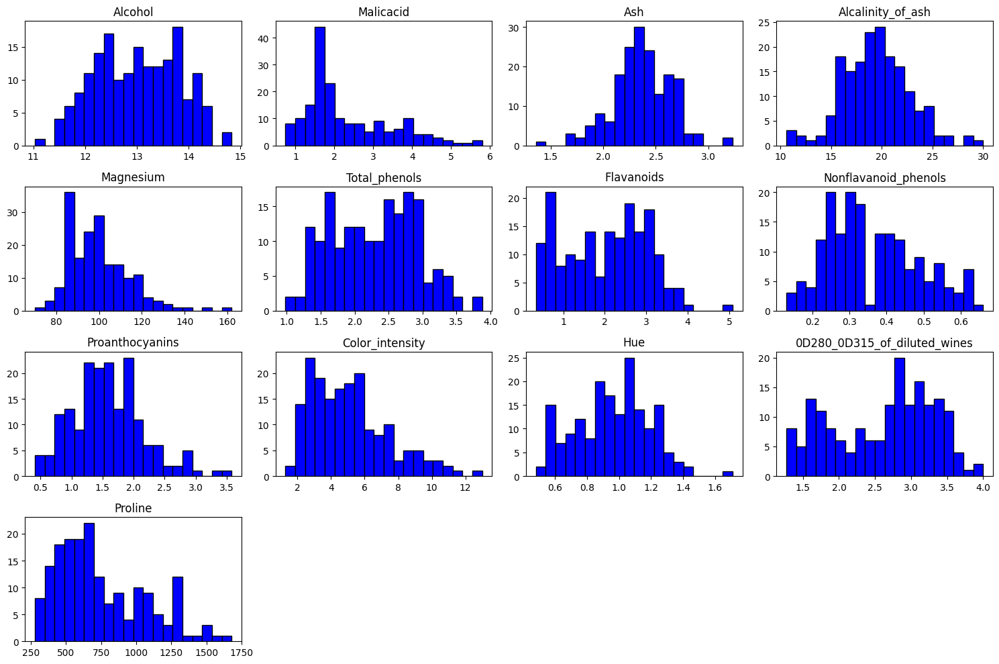

In [ ]:
# Univariate analysis
#Histograms for each feature
features = X.columns
plt.figure(figsize=(15, 10))
for i, feature in enumerate(features):
    plt.subplot(4, 4, i+1)
    plt.hist(X[feature], bins=20, color='blue', edgecolor='black')
    plt.title(f'{feature}')
    plt.tight_layout()
plt.show()

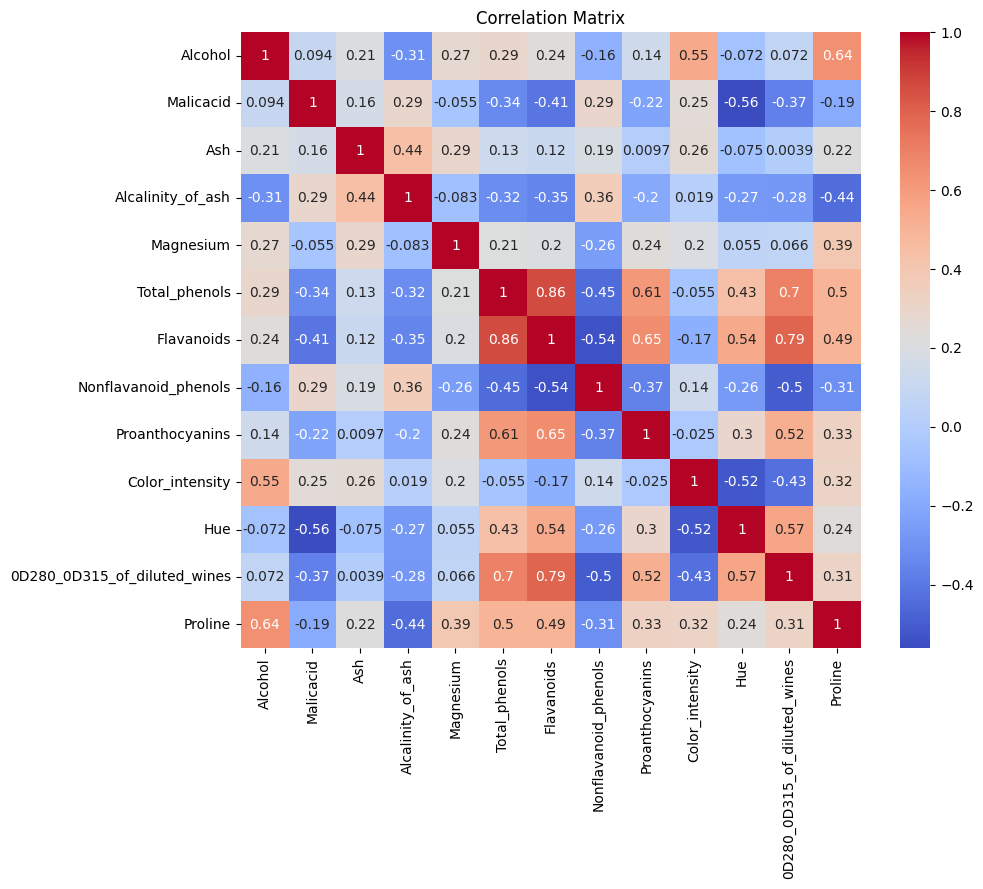

In [ ]:
# BiVariate Analysis
# Correlation Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(X.corr(), annot=True, cmap="coolwarm")
plt.title("Correlation Matrix")
plt.show()


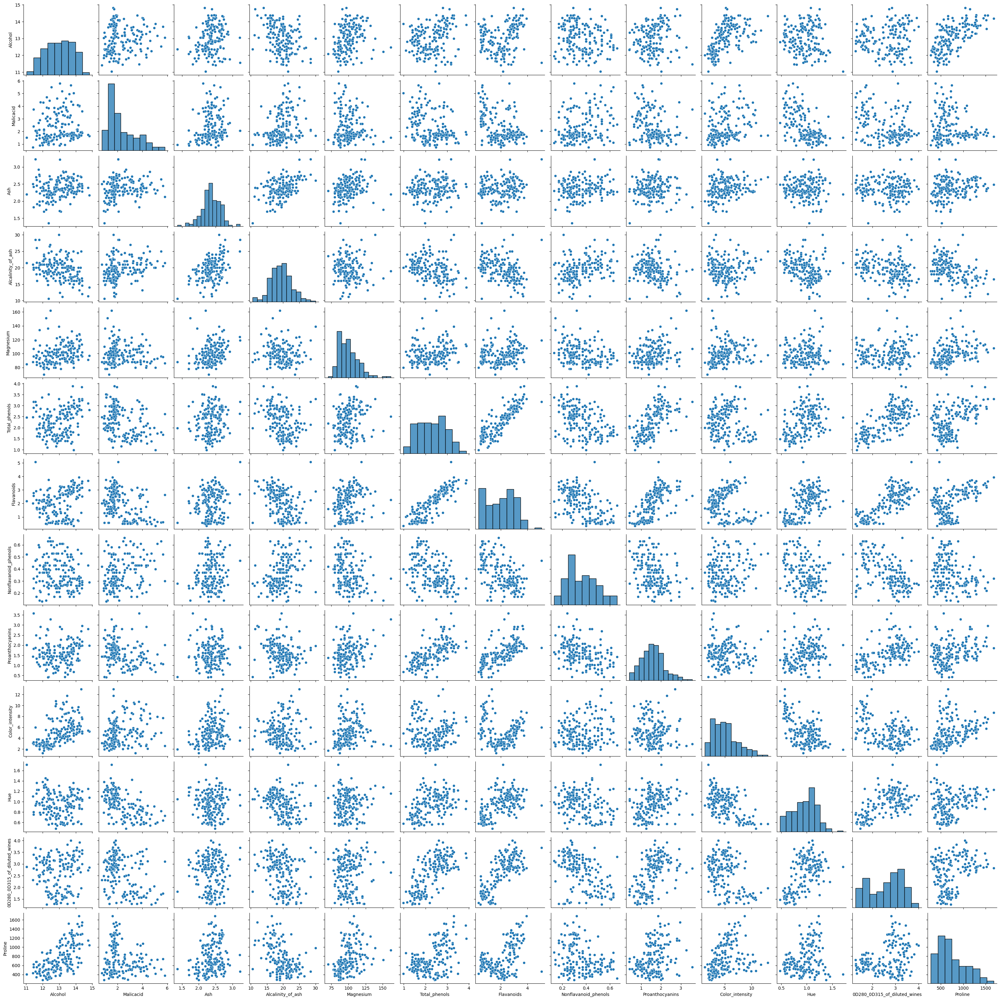

In [ ]:
# Pair Plot
sns.pairplot(X)
plt.show()

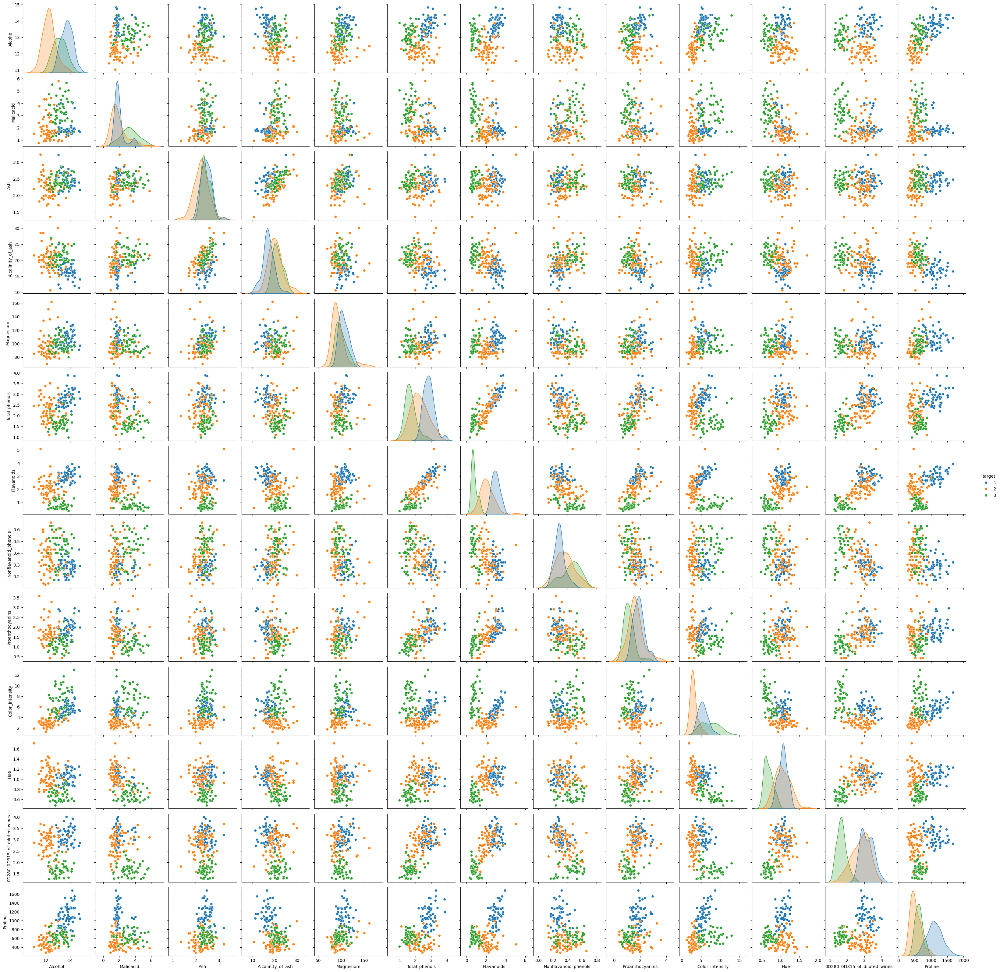

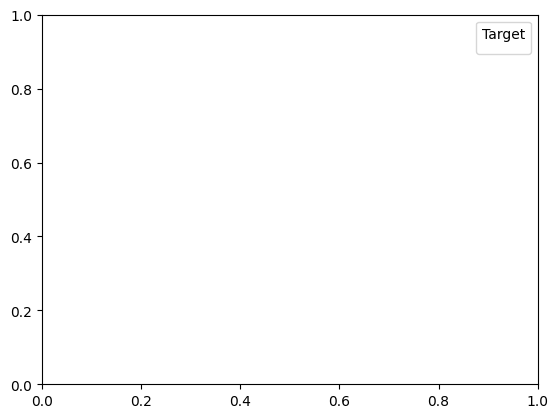

In [ ]:
#MultiVariate Analysis
#pair Plot for how wine classes are distributed throughout each feature.
custom_palette = ['#1f77b4', '#ff7f0e', '#2ca02c']
sns.pairplot(df, hue='target',palette=custom_palette)
plt.show()
plt.legend(title='Target', loc='upper right')
plt.show()

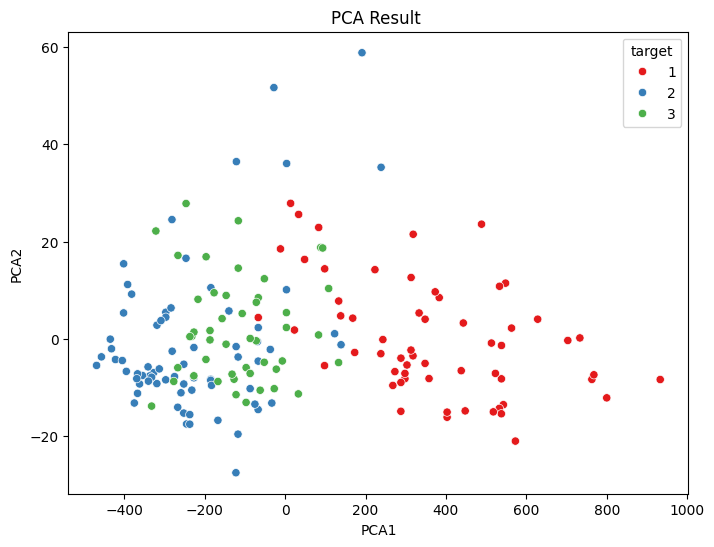

In [ ]:

#Principal Component analysis
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
pca_result = pca.fit_transform(X)

X['PCA1'] = pca_result[:, 0]
X['PCA2'] = pca_result[:, 1]
y = y.squeeze() if hasattr(y, 'squeeze') else y.ravel()

plt.figure(figsize=(8, 6))
sns.scatterplot(x=X['PCA1'], y=X['PCA2'], hue=y, palette='Set1')
plt.title("PCA Result ")
plt.show()

**Logistic Regression**

In [ ]:
#Splitting the data into training and test sets
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

**Checking for class imbalance using percentage distribution**

In [ ]:
class_percentage = y.value_counts(normalize=True) * 100
print(class_percentage)

target
2    39.887640
1    33.146067
3    26.966292
Name: proportion, dtype: float64


Our classes are somewhat proportional. Our distribution doesn't indicate any severe imbalances between the classes. In general, a dataset is considered imbalanced when one class makes up a large majority or a small minority.

In [ ]:
log_reg = LogisticRegression(random_state=42)
log_reg.fit(X_train, y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.model_selection import cross_val_score

y_pred_log = log_reg.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_log))
print("Classification Report:\n", classification_report(y_test, y_pred_log))
print("Cross-Validation Accuracy:", np.mean(cross_val_score(log_reg, X, y, cv=5)))

Confusion Matrix:
 [[18  1  0]
 [ 0 21  0]
 [ 0  0 14]]
Classification Report:
               precision    recall  f1-score   support

           1       1.00      0.95      0.97        19
           2       0.95      1.00      0.98        21
           3       1.00      1.00      1.00        14

    accuracy                           0.98        54
   macro avg       0.98      0.98      0.98        54
weighted avg       0.98      0.98      0.98        54

Cross-Validation Accuracy: 0.9555555555555555


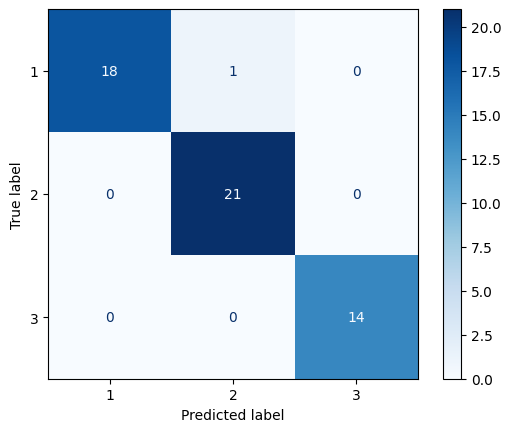

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
#Plot the confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_log, cmap = "Blues" )

**XAI FOR LOGISTIC REGRESSION**

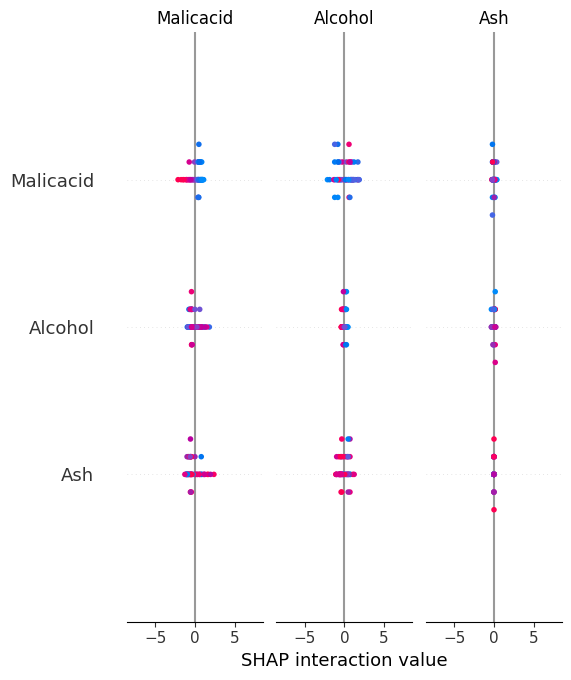

In [ ]:
import shap
import matplotlib.pyplot as plt

explainer1 = shap.Explainer(log_reg, X_train)

shap_values = explainer1(X_test)


shap.summary_plot(shap_values, X_test.values, feature_names=X_test.columns, plot_type='bar')


In [ ]:
#sample_ind=4
shap.plots.waterfall(shap_values[0], max_display=13)

ValueError: The waterfall plot can currently only plot a single explanation, but a matrix of explanations (shape (13, 3)) was passed! Perhaps try `shap.plots.waterfall(shap_values[0])` or for multi-output models, try `shap.plots.waterfall(shap_values[0, 0])`.

In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=1a82d93b058cec1c3a5423da24d16b810590d4625ff59f7717118e392256eb6a
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

feature_names = X_train.columns
class_names = ['Class 1', 'Class 2', 'Class 3']

#explainer = LimeTabularExplainer(X_train.values, feature_names=feature_names, class_names=class_names, mode='classification')

explainer2 = LimeTabularExplainer(
    training_data=X_train.values,
    feature_names=X.columns,
    mode='classification'
    )



In [ ]:
sample_idx = 4
instance = X_test.iloc[sample_idx]
exp_log = explainer2.explain_instance(instance, log_reg.predict_proba)
exp_log.show_in_notebook(show_all=False)

**Random Forest classifier**

In [ ]:
# Initialize and train the Random Forest classifier
from sklearn.ensemble import RandomForestClassifier
rf= RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
#Predictions and Evaluation
y_pred = rf.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Accuracy Score:", accuracy_score(y_test, y_pred))

Confusion Matrix:
 [[19  0  0]
 [ 0 21  0]
 [ 0  0 14]]
Classification Report:
               precision    recall  f1-score   support

           1       1.00      1.00      1.00        19
           2       1.00      1.00      1.00        21
           3       1.00      1.00      1.00        14

    accuracy                           1.00        54
   macro avg       1.00      1.00      1.00        54
weighted avg       1.00      1.00      1.00        54

Accuracy Score: 1.0


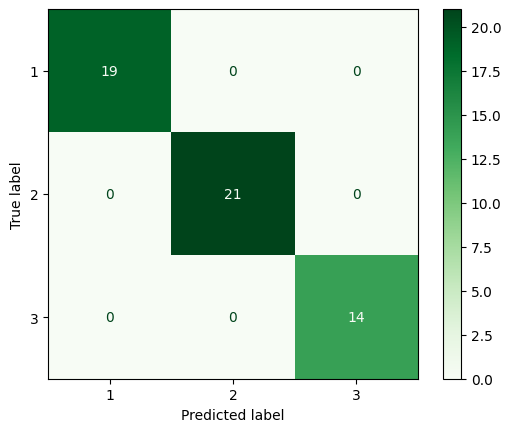

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
#Plot the confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_pred, cmap = "Greens" )

**XAI FOR RANDOM FOREST CLASSIFIER**

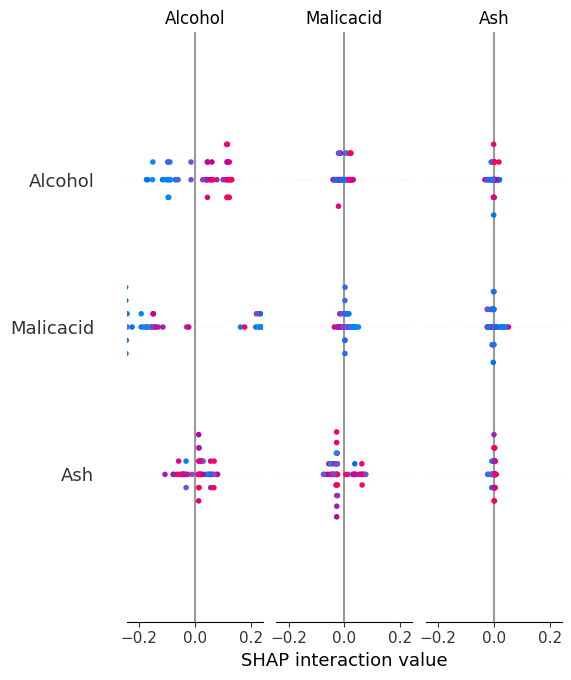

In [ ]:
import shap

rf_explainer = shap.TreeExplainer(rf)
shap_values = rf_explainer.shap_values(X_test)

shap.summary_plot(shap_values, X_test, plot_type="bar")

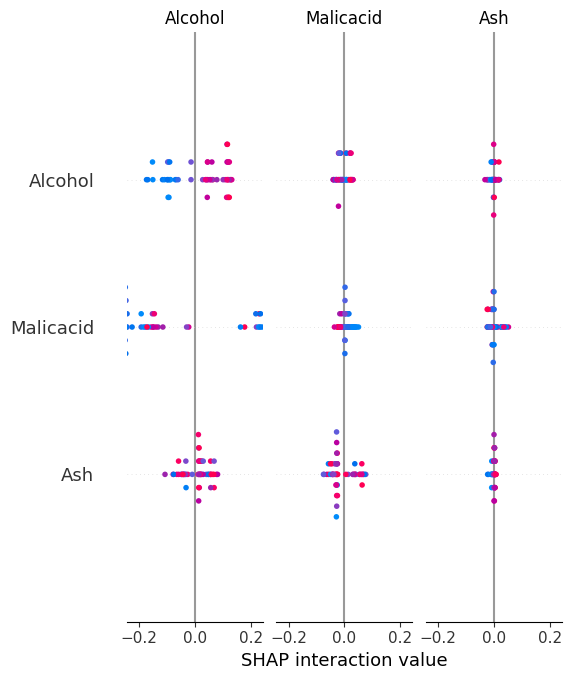

In [ ]:
shap.summary_plot(shap_values, X_test)

In [ ]:
shap.plots.waterfall(rf_explainer, max_display=13)

TypeError: The waterfall plot requires an `Explanation` object as the `shap_values` argument.

In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

feature_names = X_train.columns
class_names = ['Class 0', 'Class 1', 'Class 2']

#explainer = LimeTabularExplainer(X_train.values, feature_names=feature_names, class_names=class_names, mode='classification')

explainer = LimeTabularExplainer(X_train.values, feature_names=X_train.columns, mode='classification')
sample_idx = 14
exp_rf = explainer.explain_instance(X_test.values[sample_idx], rf.predict_proba)
exp_rf.show_in_notebook(show_table=True)

In [ ]:
y_pred = rf.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))
print("Accuracy Score:", accuracy_score(y_test, y_pred))

Confusion Matrix:
 [[18  0  0]
 [ 1 22  0]
 [ 0  0 23]]
Classification Report:
               precision    recall  f1-score   support

           0       0.95      1.00      0.97        18
           1       1.00      0.96      0.98        23
           2       1.00      1.00      1.00        23

    accuracy                           0.98        64
   macro avg       0.98      0.99      0.98        64
weighted avg       0.99      0.98      0.98        64

Accuracy Score: 0.984375


In [ ]:
# Feature importance
importances = rf.feature_importances_
features = X.columns
indices = np.argsort(importances)

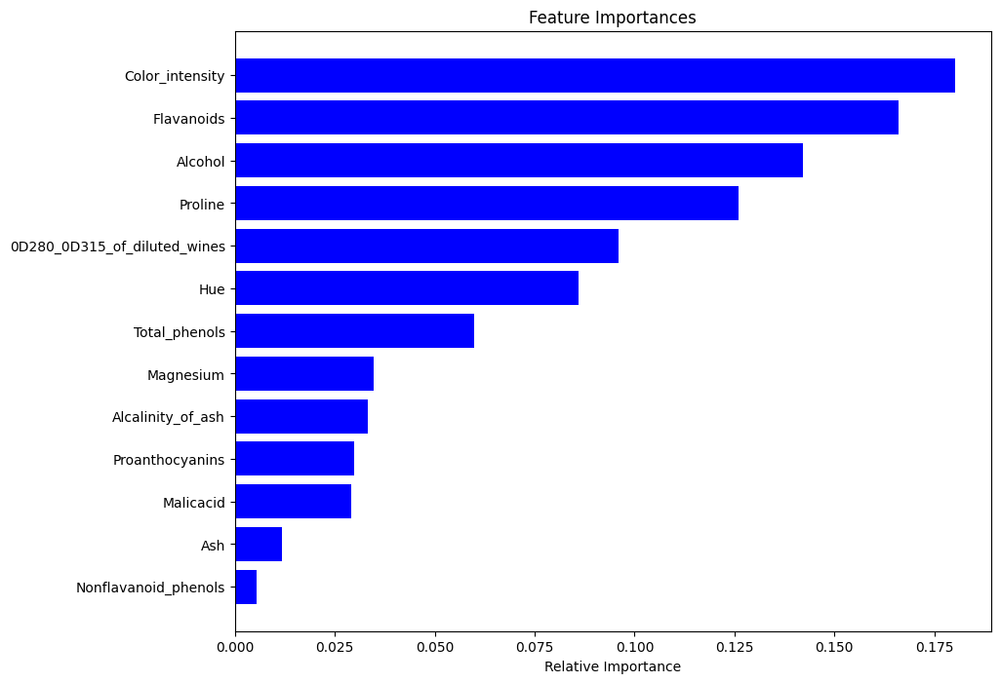

In [ ]:
plt.figure(figsize=(10, 8))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

**Our dataset is overfitting which might mean that since our dataset is small, the model might have memorised the patterns rather than generalizing them.**

In [ ]:
#Using cross-validation provides a more robust estimate of model performance
from sklearn.model_selection import cross_val_score

cross_val_scores = cross_val_score(rf, X, y, cv=5)
print("Cross-Validation Scores:", cross_val_scores)
print("Mean CV Accuracy:", np.mean(cross_val_scores))

Cross-Validation Scores: [0.97674419 0.97674419 1.         1.         1.        ]
Mean CV Accuracy: 0.9906976744186047


In [ ]:
#Using RandomizedSearchCV or GridSearchCV can help optimize parameters and prevent overfitting
from sklearn.model_selection import RandomizedSearchCV

param_dist = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

rf_random = RandomizedSearchCV(estimator=rf, param_distributions=param_dist, n_iter=10, cv=5, random_state=42, n_jobs=-1)
rf_random.fit(X_train, y_train)

print("Best Parameters:", rf_random.best_params_)
y_pred_optimized = rf_random.predict(X_test)
print("Optimized Accuracy Score:", accuracy_score(y_test, y_pred_optimized))

Best Parameters: {'n_estimators': 50, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': False}
Optimized Accuracy Score: 1.0


In [ ]:
#Addressing the slight class imbalance

from sklearn.svm import SVC
from xgboost import XGBClassifier
from imblearn.over_sampling import SMOTE


In [ ]:
# Using SMOTE
smote = SMOTE(random_state=42)
X, y = smote.fit_resample(X, y)

In [ ]:
# Split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

**Random Forest Classifier with Class weights**

In [ ]:
# 2. Random Forest Classifier with Class Weights
print("\n=== Random Forest with Class Weights ===")
rf = RandomForestClassifier(class_weight='balanced', random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_rf))
print("Classification Report:\n", classification_report(y_test, y_pred_rf))
print("Cross-Validation Accuracy:", np.mean(cross_val_score(rf, X, y, cv=5)))


=== Random Forest with Class Weights ===
Confusion Matrix:
 [[19  0  0]
 [ 0 21  0]
 [ 0  0 14]]
Classification Report:
               precision    recall  f1-score   support

           1       1.00      1.00      1.00        19
           2       1.00      1.00      1.00        21
           3       1.00      1.00      1.00        14

    accuracy                           1.00        54
   macro avg       1.00      1.00      1.00        54
weighted avg       1.00      1.00      1.00        54

Cross-Validation Accuracy: 0.9777777777777779


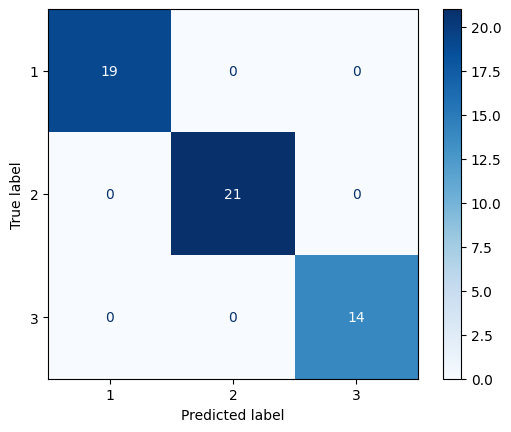

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
#Plot the confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test,y_pred_rf, cmap = "Blues" )

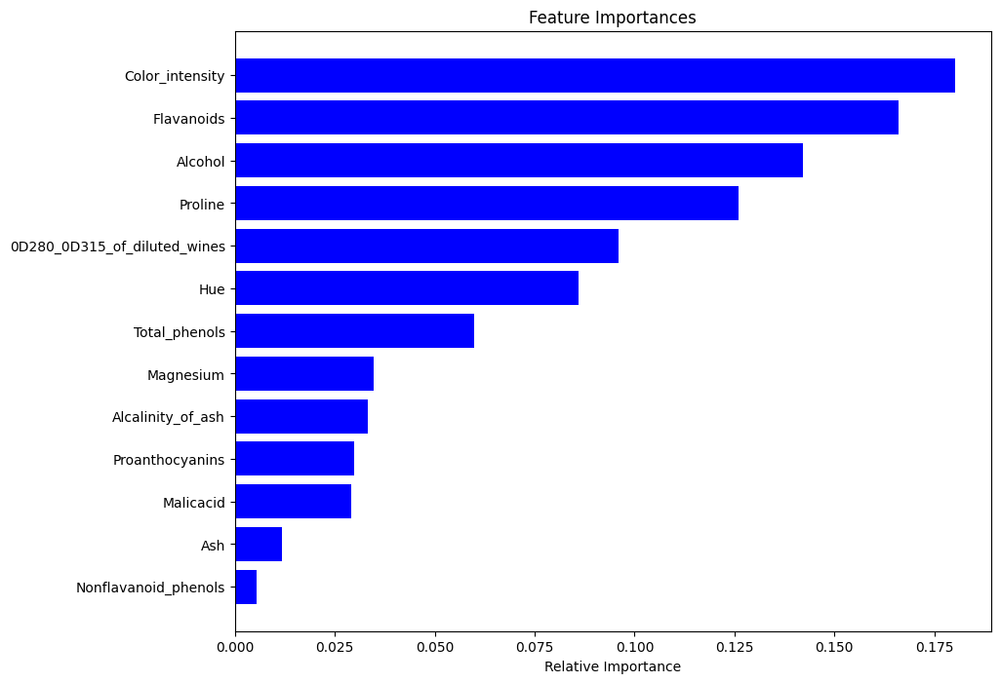

In [ ]:
# Feature Importance in Random Forest
plt.figure(figsize=(10, 8))
plt.title("Feature Importances")
plt.barh(range(len(indices)), importances[indices], color='b', align='center')
plt.yticks(range(len(indices)), [features[i] for i in indices])
plt.xlabel("Relative Importance")
plt.show()

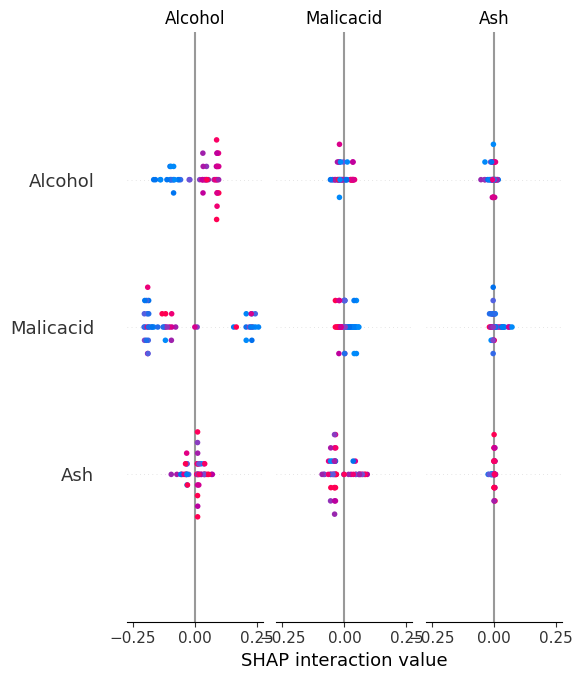

In [ ]:
explainer = shap.TreeExplainer(rf)
shap_values = explainer.shap_values(X_test)

# Summary plot for feature importance
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns)

**Support Vector Machine (SVM) with Class Weights**

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import cross_val_score
svm = SVC(kernel='rbf', random_state=42)
svm.fit(X_train, y_train)
y_pred_svm = svm.predict(X_test)
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_svm))
print("Classification Report:\n", classification_report(y_test, y_pred_svm))
print("Cross-Validation Accuracy:", np.mean(cross_val_score(svm, X, y, cv=5)))

Confusion Matrix:
 [[19  0  0]
 [ 0 19  2]
 [ 0 11  3]]
Classification Report:
               precision    recall  f1-score   support

           1       1.00      1.00      1.00        19
           2       0.63      0.90      0.75        21
           3       0.60      0.21      0.32        14

    accuracy                           0.76        54
   macro avg       0.74      0.71      0.69        54
weighted avg       0.75      0.76      0.72        54

Cross-Validation Accuracy: 0.6634920634920635


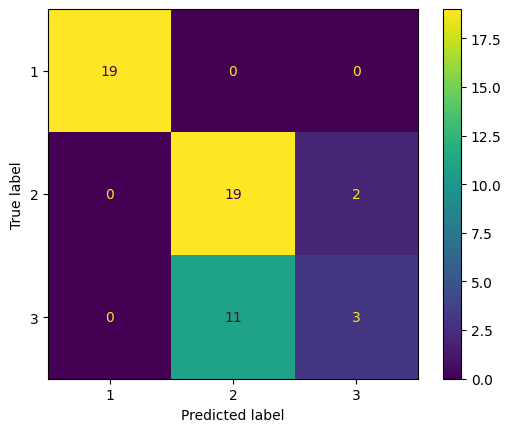

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
#Plot the confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_svm)

  0%|          | 0/54 [00:00<?, ?it/s]

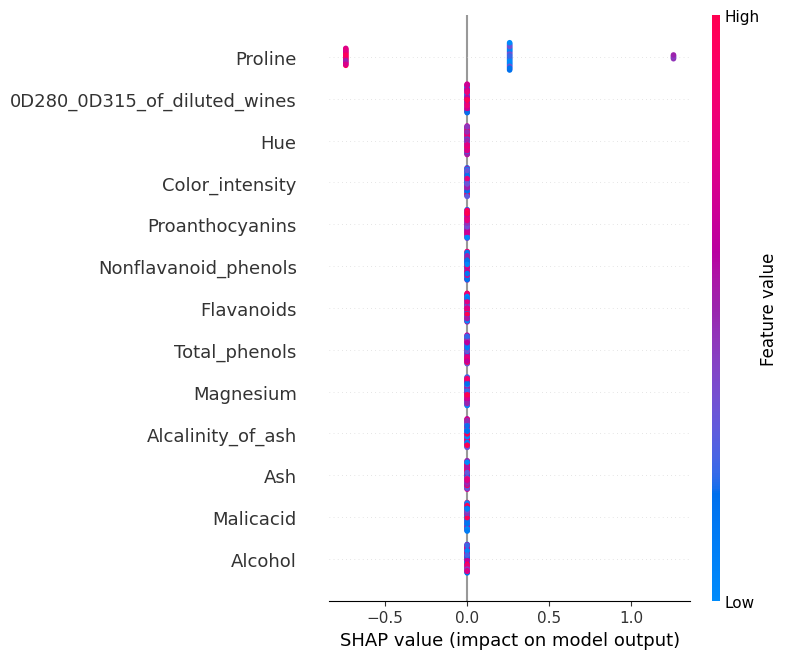

In [ ]:
import shap
import numpy as np

explainer3 = shap.KernelExplainer(svm.predict, X_test)
shap_values = explainer.shap_values(X_test)

# Summary plot for feature importance
shap.summary_plot(shap_values, X_test)

In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

feature_names = X_train.columns
class_names = ['Class 0', 'Class 1', 'Class 2']

#explainer = LimeTabularExplainer(X_train.values, feature_names=feature_names, class_names=class_names, mode='classification')

explainer = LimeTabularExplainer(X_train.values, feature_names=X_train.columns, mode='classification')
sample_idx = 14
exp_svm = explainer.explain_instance(X_test.values[sample_idx], svm.predict_proba)
exp_svm.show_in_notebook(show_table=True)

In [ ]:
df_1 = df.copy()

**XGBoost with Scale Pos Weight for Class Imbalance**

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import classification_report, confusion_matrix
from xgboost import XGBClassifier

# Adjust target labels to start from 0
df_2['target'] = df_2['target'] - 1

# Define features and target
X = df_2.drop(columns=['target'])
y = df_2['target']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the XGBClassifier (remove `scale_pos_weight` unless it's for binary imbalance)
model = XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred_xgb = model.predict(X_test)

# Print evaluation metrics
print("Confusion Matrix:\n", confusion_matrix(y_test, y_pred_xgb))
print("Classification Report:\n", classification_report(y_test, y_pred_xgb))

# Perform cross-validation and print the average accuracy
cv_accuracy = np.mean(cross_val_score(model, X, y, cv=5))
print("Cross-Validation Accuracy:", cv_accuracy)


Confusion Matrix:
 [[13  1  0]
 [ 0 14  0]
 [ 0  1  7]]
Classification Report:
               precision    recall  f1-score   support

           0       1.00      0.93      0.96        14
           1       0.88      1.00      0.93        14
           2       1.00      0.88      0.93         8

    accuracy                           0.94        36
   macro avg       0.96      0.93      0.94        36
weighted avg       0.95      0.94      0.94        36

Cross-Validation Accuracy: 0.9498412698412698


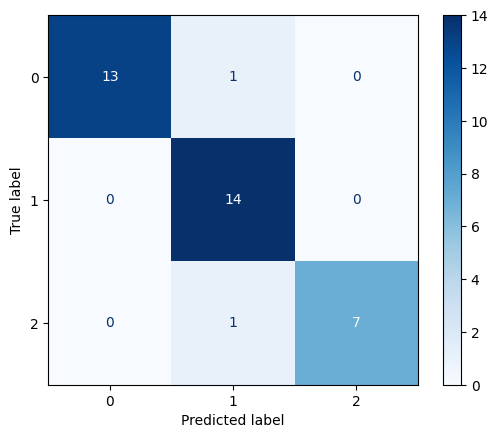

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
#Plot the confusion Matrix
ConfusionMatrixDisplay.from_predictions(y_test,y_pred_xgb, cmap = "Blues" )

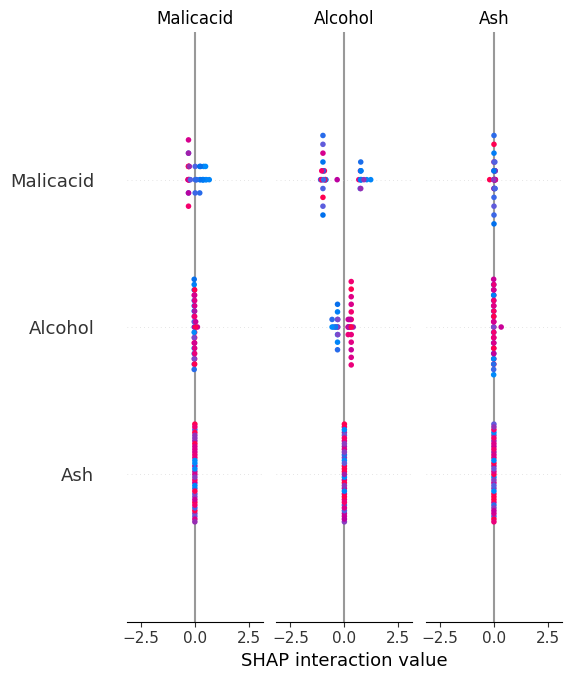

In [ ]:
import shap
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, X_test.values, feature_names=X_test.columns)

In [ ]:
from lime.lime_tabular import LimeTabularExplainer
import numpy as np

feature_names = X_train.columns
class_names = ['Class 0', 'Class 1', 'Class 2']

explainer = LimeTabularExplainer(X_train.values, feature_names=feature_names, class_names=class_names, mode='classification')

#explainer = LimeTabularExplainer(X_train.values, feature_names=X_train.columns, mode='classification')
sample_idx = 0
exp_xgb = explainer.explain_instance(X_test.values[sample_idx], model.predict_proba)
exp_xgb.show_in_notebook(show_table=True)

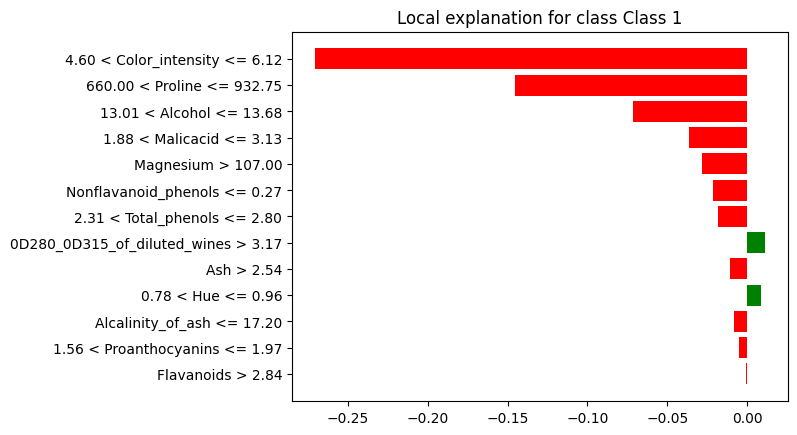

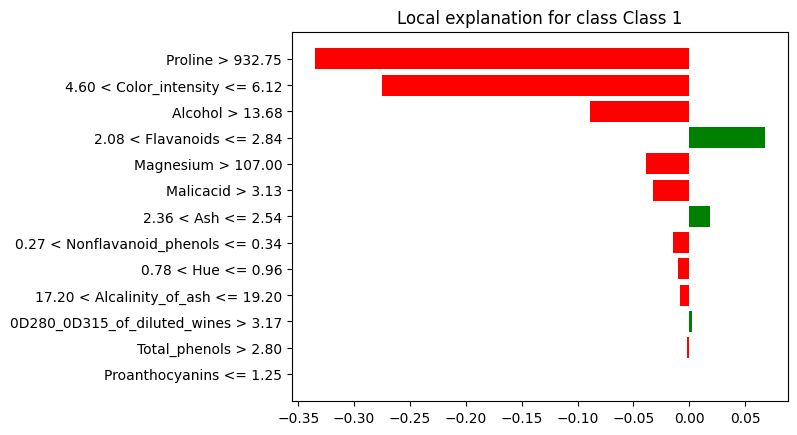

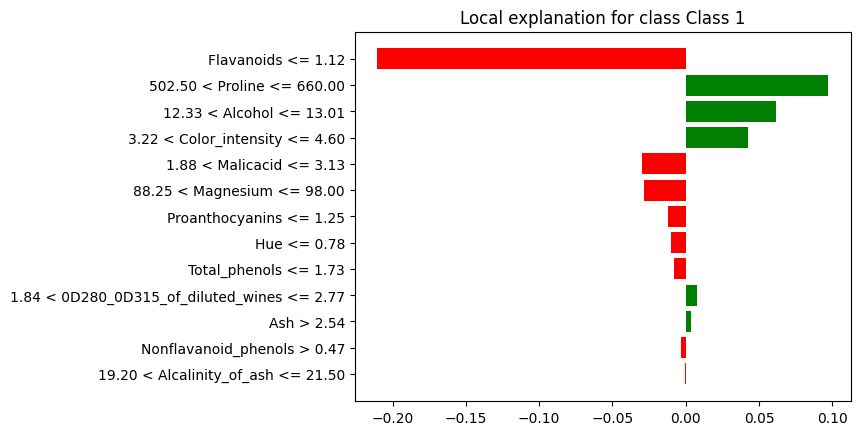

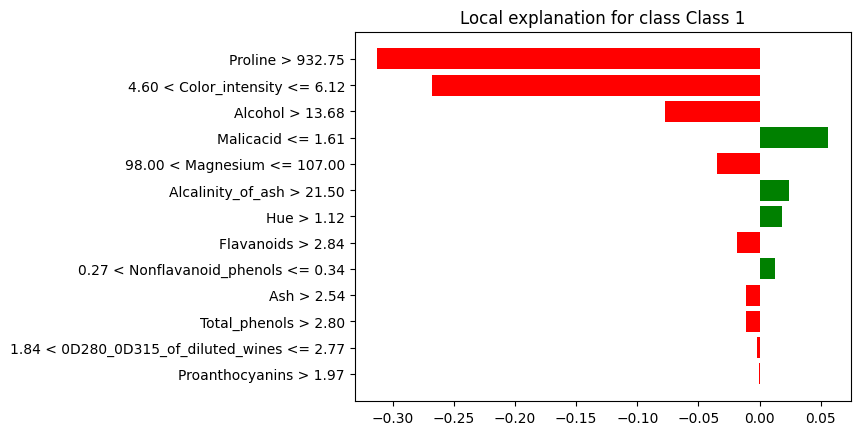

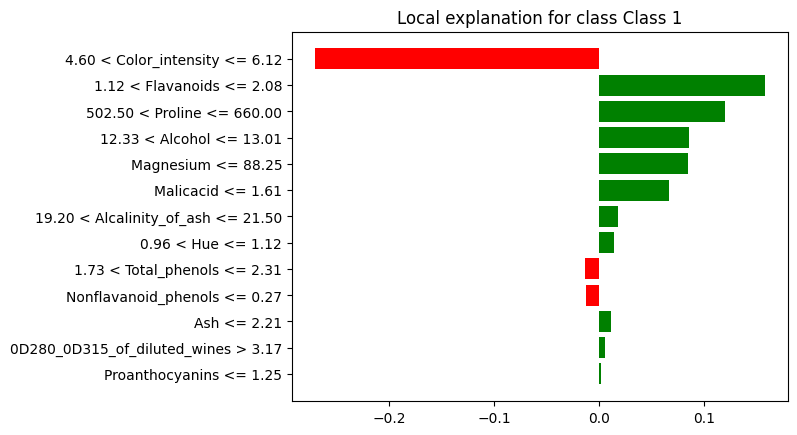

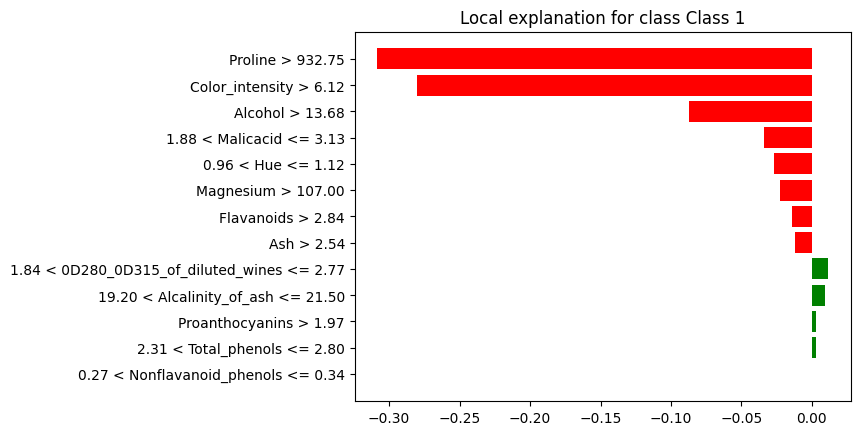

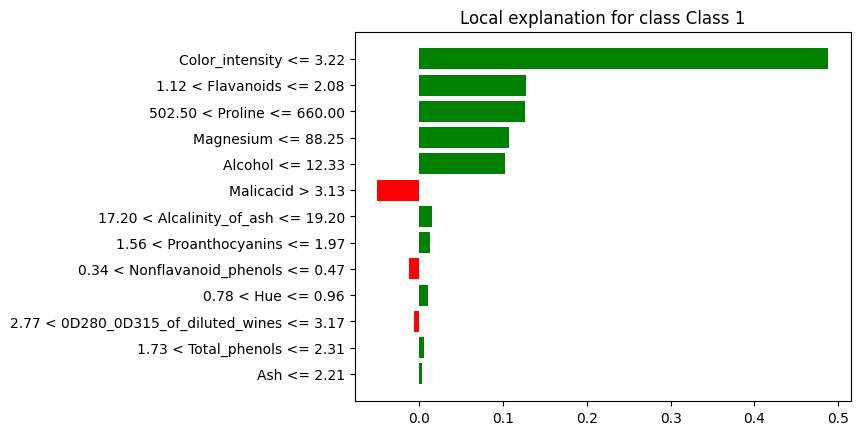

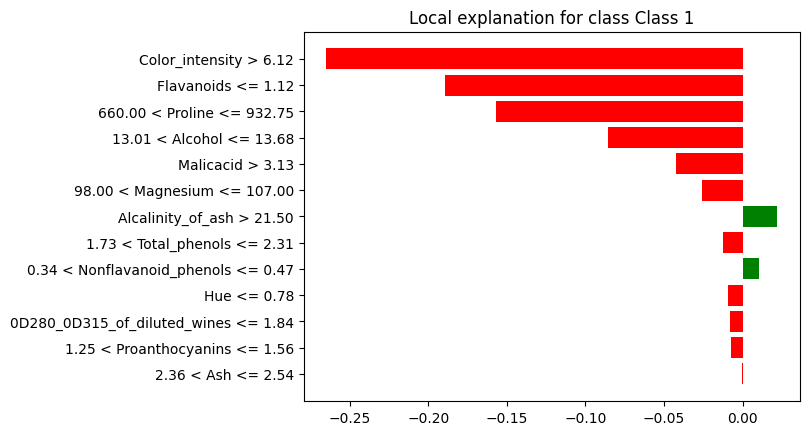

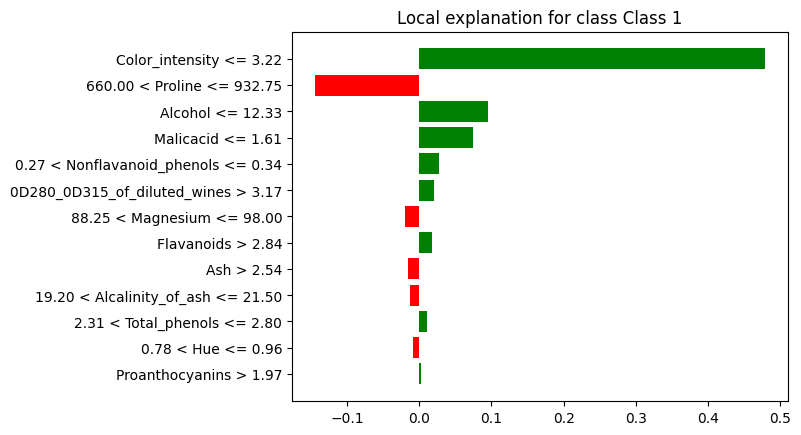

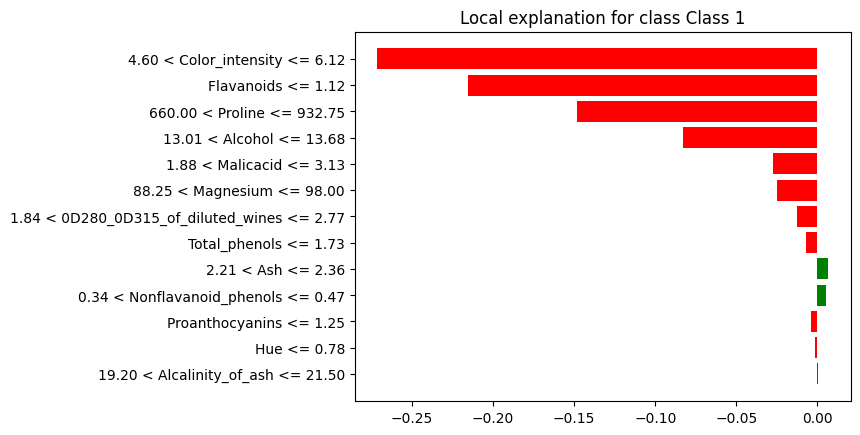

In [ ]:
# XGBoost with Lime

feature_names = X_train.columns
class_names = ['Class 0', 'Class 1', 'Class 2']
explainer = LimeTabularExplainer(X_train.values, feature_names=X_train.columns, class_names=class_names, mode='classification', discretize_continuous=True)

#

for sample_idx in range(10):
    exp_xgb = explainer.explain_instance(X_test.values[sample_idx], model.predict_proba, num_features=13)
    exp_xgb.show_in_notebook(show_table=True)
    exp_xgb.as_pyplot_figure()